<img src="./img/monthly_GRSM.png" style="width: 600px;"/>

__Clik__ <a href=./map/network_GRSM_2018-08-02.html>map</a>

# Part 1: road network analysis, an example of Yellowstone National Park
## 3. Network analysis

In [4]:
HTML(filename = 'map/network_GRSM_2018-08-02.html')

In [2]:
from IPython.display import Image
from IPython.display import HTML

In [1]:
import geopandas as gpd  
import pandas as pd
from geopandas.tools import geocode
from ast import literal_eval
import matplotlib.pyplot as plt
import geoplot
import osmnx as ox
import networkx as nx
from tqdm import tqdm, trange

In [2]:
# Set to display all columns and rows
pd.set_option("display.max_rows", None, "display.max_columns", None)

Specify the unit code of the park, then load cleaned GeoJSON file and park boundary shapefile:

In [3]:
park = 'YELL'
# cleaned Safegraph data at POI level
subset_gdf = gpd.read_file(f"../clean_data/POI_{park}.geojson")
# park boundary
boundary = gpd.read_file('../raw_data/nps_boundary/nps_boundary.shp')
boundary = boundary.set_index('UNIT_CODE')

Load entrance station info:

In [14]:
entry = pd.read_csv(f'../raw_data/entrance_coord.csv')
# split by "," to create lontitude and latitude columns
lat = []
lon = []

for row in entry['lat_lon']:
    lat.append(row.split(',')[0]) # Split the row by comma and append
    lon.append(row.split(',')[1])
        
# Create two new columns from lat and lon
entry['lat'] = lat
entry['lon'] = lon

In [37]:
# convert to geodataframe
entry_gdf = gpd.GeoDataFrame(entry, 
                             crs = "EPSG:4269",
                             geometry = gpd.points_from_xy(entry.lon, entry.lat))
# filter the entrance stations for that park
entry_gdf = entry_gdf[entry_gdf.unitCode == park].reset_index(drop = True) 
entry_gdf

,unitCode,entrance,lat_lon,lat,lon,geometry
0,YELL,North,"45.02533214022773, -110.70077613702115",45.02533214022773,-110.70077613702115,POINT (-110.70078 45.02533)
1,YELL,West,"44.65675734348095, -111.08988553970507",44.65675734348095,-111.08988553970507,POINT (-111.08989 44.65676)
2,YELL,South,"44.135784033296666, -110.6668290906966",44.135784033296666,-110.6668290906966,POINT (-110.66683 44.13578)
3,YELL,East,"44.48859569172154, -110.00387389836672",44.48859569172154,-110.00387389836672,POINT (-110.00387 44.48860)
4,YELL,Northeast,"45.00452938664046, -110.0104131407937",45.00452938664046,-110.0104131407937,POINT (-110.01041 45.00453)


### (1) For parks with convex shape (Glacier, Yellowstone, Smokies), it's ideal to buffer around the park boudary and use this buffer to query osm road network

In [6]:
# To create buffer, need to first project to UTM (unit: meters)
buff = boundary.loc[[park]].to_crs(epsg = 26912).buffer(8000) # For Glacier: NAD83 / UTM zone 12N
buff = gpd.GeoDataFrame(geometry = gpd.GeoSeries(buff))
buff

,geometry
UNIT_CODE,
YELL,"POLYGON ((484360.252 4981509.974, 484359.133 4..."


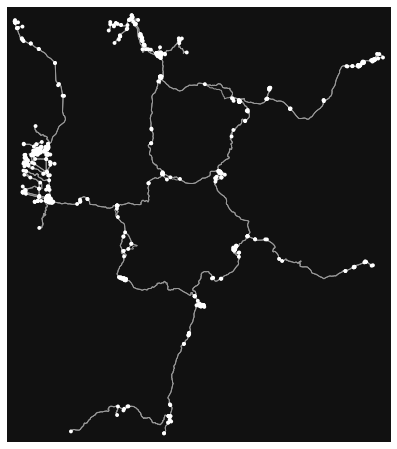

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [7]:
# create network from that buffer
G = ox.graph_from_polygon(buff.to_crs(epsg = 4326).geometry[0], network_type = 'drive', simplify = True)
# Reproject
G = ox.project_graph(G, to_crs = 'epsg:4269')
ox.plot_graph(G)

In [8]:
nodes, edges = ox.graph_to_gdfs(G, nodes = True, edges = True, node_geometry = True)
edges.head()

osmid       highway  \
u         v         key                                                   
158216425 465785452 0    [269330292, 39058700, 269330294]  unclassified   
          465805251 0    [106471688, 82809818, 106471684]  unclassified   
          158216521 0                           269330285  unclassified   
465785452 158216425 0    [269330292, 39058700, 269330294]  unclassified   
465805251 465805245 0                            39061386  unclassified   

                         oneway     length bridge  \
u         v         key                             
158216425 465785452 0     False    376.615    yes   
          465805251 0     False  16791.272    yes   
          158216521 0     False   1502.607    NaN   
465785452 158216425 0     False    376.615    yes   
465805251 465805245 0     False     55.218    NaN   

                                                                  geometry  \
u         v         key                                                      
158216425 465785452 0    LINESTRING (-110.81707 44.13179, -110.81741 44...   
          465805251 0    LINESTRING (-110.81707 44.13179, -110.81689 44...   
          158216521 0    LINESTRING (-110.81707 44.13179, -110.81714 44...   
465785452 158216425 0    LINESTRING (-110.82061 44.13143, -110.82051 44...   
465805251 465805245 0    LINESTRING (-110.67317 44.10727, -110.67314 44...   

                                     name lanes  ref maxspeed tunnel access  \
u         v         key                                                       
158216425 465785452 0                 NaN   NaN  NaN      NaN    NaN    NaN   
          465805251 0    Grassy Lake Road   NaN  NaN      NaN    NaN    NaN   
          158216521 0    Grassy Lake Road   NaN  NaN      NaN    NaN    NaN   
465785452 158216425 0                 NaN   NaN  NaN      NaN    NaN    NaN   
465805251 465805245 0                 NaN   NaN  NaN      NaN    NaN    NaN   

                        width  
u         v         key        
158216425 465785452 0     NaN  
          465805251 0     NaN  
          158216521 0     NaN  
465785452 158216425 0     NaN  
465805251 465805245 0     NaN

### (2) For parks with concave shape (Zion and Acadia), better to use the bounding box instead of a buffer.

In [9]:
# # create bounding box based on park boundary
# bound = boundary.loc[[park]].total_bounds  
# # Specify the coordinates of four bounds
# north, south, east, west = bound[3], bound[1], bound[2], bound[0]
# # create network from that bounding box
# G = ox.graph_from_bbox(north, south, east, west, network_type = 'drive', simplify = True)
# ox.plot_graph(G)

### Choose a date that we would like to study: the purpose is to compare the congestion conditions between the same time period of different years, such as the first Friday of August in 2018 vs. 2020.

In [70]:
subset_gdf.head()

,date_range_start,date_range_end,placekey,sg_c__parent_placekey,sg_c__location_name,sg_c__safegraph_brand_ids,sg_c__brands,sg_c__top_category,sg_c__sub_category,sg_c__naics_code,sg_c__latitude,sg_c__longitude,sg_c__street_address,sg_c__city,sg_c__region,sg_c__postal_code,sg_c__iso_country_code,sg_c__phone_number,sg_c__open_hours,sg_c__category_tags,sg_c__opened_on,sg_c__closed_on,sg_c__tracking_closed_since,sg_c__geometry_type,sg_mp__parent_placekey,sg_mp__location_name,sg_mp__street_address,sg_mp__city,sg_mp__region,sg_mp__postal_code,sg_mp__safegraph_brand_ids,sg_mp__brands,sg_mp__date_range_start,sg_mp__date_range_end,sg_mp__raw_visit_counts,sg_mp__raw_visitor_counts,sg_mp__visits_by_day,sg_mp__poi_cbg,sg_mp__visitor_home_cbgs,sg_mp__visitor_daytime_cbgs,sg_mp__visitor_country_of_origin,sg_mp__distance_from_home,sg_mp__median_dwell,sg_mp__bucketed_dwell_times,sg_mp__related_same_day_brand,sg_mp__related_same_month_brand,sg_mp__popularity_by_day,sg_mp__device_type,sg_mp__normalized_visits_by_state_scaling,sg_mp__normalized_visits_by_total_visits,sg_mp__normalized_visits_by_total_visitors,sg_mp__normalized_visits_by_region_naics_visits,sg_mp__normalized_visits_by_region_naics_visitors,n_of_day,date,geometry
0,2020-06-01T00:00:00,2020-07-01,zzy-222@5wf-jgg-7t9,None,The Boiling River,None,None,Spectator Sports,Sports Teams and Clubs,711211.0,44.992398,-110.691908,Hwy 89,Gardiner,MT,59030.0,US,NaN,None,None,None,None,2019-07-01,POLYGON,None,The Boiling River,Hwy 89,Gardiner,mt,59030.0,None,None,2020-06-01T00:00:00-06:00,2020-07-01T00:00:00-06:00,14.0,7.0,0,3.006798e+11,{},"{'290099605001': 4, '171194034011': 4, '170730...",{'US': 9},1687592.0,101.0,"{'<5': 0, '5-10': 4, '11-20': 0, '21-60': 2, '...","{'Walmart': 15, 'TacoTime': 15, 'Chevron': 15,...","{'Walmart': 86, 'McDonald's': 86, 'Holiday Sta...","{'Monday': 2, 'Tuesday': 0, 'Wednesday': 0, 'T...","{'android': 4, 'ios': 4}",260.415858,0.000004,0.000005,0.005158,0.011032,0,2020-06-01,POINT (-110.69191 44.99240)
1,2020-06-01T00:00:00,2020-07-01,zzy-222@5wf-jgg-7t9,None,The Boiling River,None,None,Spectator Sports,Sports Teams and Clubs,711211.0,44.992398,-110.691908,Hwy 89,Gardiner,MT,59030.0,US,NaN,None,None,None,None,2019-07-01,POLYGON,None,The Boiling River,Hwy 89,Gardiner,mt,59030.0,None,None,2020-06-01T00:00:00-06:00,2020-07-01T00:00:00-06:00,14.0,7.0,0,3.006798e+11,{},"{'290099605001': 4, '171194034011': 4, '170730...",{'US': 9},1687592.0,101.0,"{'<5': 0, '5-10': 4, '11-20': 0, '21-60': 2, '...","{'Walmart': 15, 'TacoTime': 15, 'Chevron': 15,...","{'Walmart': 86, 'McDonald's': 86, 'Holiday Sta...","{'Monday': 2, 'Tuesday': 0, 'Wednesday': 0, 'T...","{'android': 4, 'ios': 4}",260.415858,0.000004,0.000005,0.005158,0.011032,1,2020-06-02,POINT (-110.69191 44.99240)
2,2020-06-01T00:00:00,2020-07-01,zzy-222@5wf-jgg-7t9,None,The Boiling River,None,None,Spectator Sports,Sports Teams and Clubs,711211.0,44.992398,-110.691908,Hwy 89,Gardiner,MT,59030.0,US,NaN,None,None,None,None,2019-07-01,POLYGON,None,The Boiling River,Hwy 89,Gardiner,mt,59030.0,None,None,2020-06-01T00:00:00-06:00,2020-07-01T00:00:00-06:00,14.0,7.0,0,3.006798e+11,{},"{'290099605001': 4, '171194034011': 4, '170730...",{'US': 9},1687592.0,101.0,"{'<5': 0, '5-10': 4, '11-20': 0, '21-60': 2, '...","{'Walmart': 15, 'TacoTime': 15, 'Chevron': 15,...","{'Walmart': 86, 'McDonald's': 86, 'Holiday Sta...","{'Monday': 2, 'Tuesday': 0, 'Wednesday': 0, 'T...","{'android': 4, 'ios': 4}",260.415858,0.000004,0.000005,0.005158,0.011032,2,2020-06-03,POINT (-110.69191 44.99240)
3,2020-06-01T00:00:00,2020-07-01,zzy-222@5wf-jgg-7t9,None,The Boiling River,None,None,Spectator Sports,Sports Teams and Clubs,711211.0,44.992398,-110.691908,Hwy 89,Gardiner,MT,59030.0,US,NaN,None,None,None,None,2019-07-01,POLYGON,None,The Boiling River,Hwy 89,Gardiner,mt,59030.0,None,None,2020-06-01T00:00:00-06:00,2020-07-01T00:00:00-06:00,14.0,7.0,0,3.006798e+11,{},"{'290099605001': 4, '171194034011': 4, '170730...",{'US': 9},1687592.0,101.0,"{'<5': 0, '5-1

In [69]:
subset_gdf['date'].dtypes

dtype('<M8[ns]')

In [68]:
day = '2018-08-02'

# convert string to datetime
subset_gdf['date'] = pd.DatetimeIndex(subset_gdf.date)
# convert to numeric
subset_gdf['sg_mp__visits_by_day'] = pd.to_numeric(subset_gdf['sg_mp__visits_by_day']) 
poi_gdf = subset_gdf.loc[subset_gdf['date'] == day, 
                         ['placekey', 'date', 'sg_c__location_name', 'geometry', 'sg_mp__visits_by_day']].reset_index(drop = True)
poi_gdf

,placekey,date,sg_c__location_name,geometry,sg_mp__visits_by_day
0,zzy-222@5wf-jgg-7t9,2018-08-02,The Boiling River,POINT (-110.69191 44.99240),7
1,222-222@5wg-hzm-28v,2018-08-02,Delaware North Park Srvcs At Yellowstone,POINT (-111.09055 44.65505),4
2,zzy-222@5wg-hzm-99f,2018-08-02,Montana Workcare,POINT (-111.09594 44.65677),0
3,zzy-224@5wg-h6c-6rk,2018-08-02,Lake Lodge Cabins,POINT (-110.57477 44.41549),0
4,zzy-223@5wg-h6c-6rk,2018-08-02,Yellowstone Park Service Stations,POINT (-110.82814 44.46046),38
5,zzy-222@5wf-jgc-dvz,2018-08-02,Yellowstone Park Service Stations,POINT (-110.69867 44.97647),39
6,zzy-222@5wg-h6c-9s5,2018-08-02,Obsidian Room,POINT (-110.82992 44.45680),12
7,zzy-222@5wg-ky9-t7q,2018-08-02,Canyon Lodge and Cabins,POINT (-110.48971 44.73385),54
8,zzy-222@5wg-mdf-pd9,2018-08-02,Grand Canyon of the Yellowstone,POINT (-110.49964 44.71292),3
9,zzy-22h@5wg-k4r-yn5,2018-08-02,Lake Lodge Cafeteria,POINT (-110.39574 44.55527),6


Plot entrance stations (start) and POIs (end) together with the park road network:

In [59]:
m = edges[edges.highway == 'secondary'].explore()
poi_gdf.drop(['date'], axis = 1).explore(m = m, 
                                         column = 'sg_mp__visits_by_day', 
                                         cmap = "RdBu_r",
                                         marker_type = 'circle',
                                         marker_kwds = {'radius': 1000,
                                                        'fill': True
                                                       }
                                        ) # POIs
entry_gdf.explore(m = m, 
                  marker_type = 'marker'
                 ) # entrances

In [33]:
# A function helps you to find the nearest OSM node from a given GeoDataFrame
def find_nearest_osm(network, gdf):
    """
    # This function helps you to find the nearest OSM node from a given GeoDataFrame
    # If geom type is point, it will take it without modification, but 
    # IF geom type is polygon or multipolygon, it will take its centroid to calculate the nearest element. 
    
    Input: 
    - network (NetworkX MultiDiGraph): Network Dataset obtained from OSMnx
    - gdf (GeoDataFrame): stores locations in its `geometry` column 
    
    Output:
    - gdf (GeoDataFrame): will have `nearest_osm` column, which describes the nearest OSM node 
                          that was computed based on its geometry column
      
    """
    for idx, row in tqdm(gdf.iterrows(), total=gdf.shape[0]):
        if row.geometry.geom_type == 'Point':
            nearest_osm = ox.distance.nearest_nodes(network, 
                                                    X=row.geometry.x, 
                                                    Y=row.geometry.y
                                                   )
        elif row.geometry.geom_type == 'Polygon' or row.geometry.geom_type == 'MultiPolygon':
            nearest_osm = ox.distance.nearest_nodes(network, 
                                        X=row.geometry.centroid.x, 
                                        Y=row.geometry.centroid.y
                                       )
        else:
            print(row.geometry.geom_type)
            continue

        gdf.at[idx, 'nearest_osm'] = nearest_osm

    return gdf

In [34]:
poi_gdf = find_nearest_osm(G, poi_gdf)
poi_gdf

100%|█████████████████████████████████████████████████████████████████████████████████| 46/46 [00:00<00:00, 173.97it/s]


,placekey,date,sg_c__location_name,geometry,sg_mp__visits_by_day,nearest_osm
0,zzy-222@5wf-jgg-7t9,2018-08-02,The Boiling River,POINT (-110.69191 44.99240),7,2.611856e+08
1,222-222@5wg-hzm-28v,2018-08-02,Delaware North Park Srvcs At Yellowstone,POINT (-111.09055 44.65505),4,1.209407e+09
2,zzy-222@5wg-hzm-99f,2018-08-02,Montana Workcare,POINT (-111.09594 44.65677),0,1.209408e+09
3,zzy-224@5wg-h6c-6rk,2018-08-02,Lake Lodge Cabins,POINT (-110.57477 44.41549),0,8.565799e+09
4,zzy-223@5wg-h6c-6rk,2018-08-02,Yellowstone Park Service Stations,POINT (-110.82814 44.46046),38,1.581652e+08
5,zzy-222@5wf-jgc-dvz,2018-08-02,Yellowstone Park Service Stations,POINT (-110.69867 44.97647),39,1.577615e+08
6,zzy-222@5wg-h6c-9s5,2018-08-02,Obsidian Room,POINT (-110.82992 44.45680),12,1.209891e+09
7,zzy-222@5wg-ky9-t7q,2018-08-02,Canyon Lodge and Cabins,POINT (-110.48971 44.73385),54,1.200508e+09
8,zzy-222@5wg-mdf-pd9,2018-08-02,Grand Canyon of the Yellowstone,POINT (-110.49964 44.71292),3,1.209315e+09
9,zzy-22h@5wg-k4r-yn5,2018-08-02,Lake Lodge Cafeteria,POINT (-110.39574 44.55527),6,2.838702e+09


In [38]:
entry_gdf = find_nearest_osm(G, entry_gdf)
entry_gdf

100%|███████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 143.15it/s]


,unitCode,entrance,lat_lon,lat,lon,geometry,nearest_osm
0,YELL,North,"45.02533214022773, -110.70077613702115",45.02533214022773,-110.70077613702115,POINT (-110.70078 45.02533),2.820026e+09
1,YELL,West,"44.65675734348095, -111.08988553970507",44.65675734348095,-111.08988553970507,POINT (-111.08989 44.65676),8.782759e+08
2,YELL,South,"44.135784033296666, -110.6668290906966",44.135784033296666,-110.6668290906966,POINT (-110.66683 44.13578),4.657851e+08
3,YELL,East,"44.48859569172154, -110.00387389836672",44.48859569172154,-110.00387389836672,POINT (-110.00387 44.48860),1.209243e+09
4,YELL,Northeast,"45.00452938664046, -110.0104131407937",45.00452938664046,-110.0104131407937,POINT (-110.01041 45.00453),1.199257e+09


In [39]:
routes = nx.shortest_path(G = G, 
                          source = entry_gdf.loc[0, 'nearest_osm'], 
                          target = poi_gdf.loc[0, 'nearest_osm'], 
                          weight = 'length',
                          method = 'dijkstra'
                         )
routes # From Jammer Joe's Grill and Pizzeria to West Entrance

[2820025556.0, 261185594]

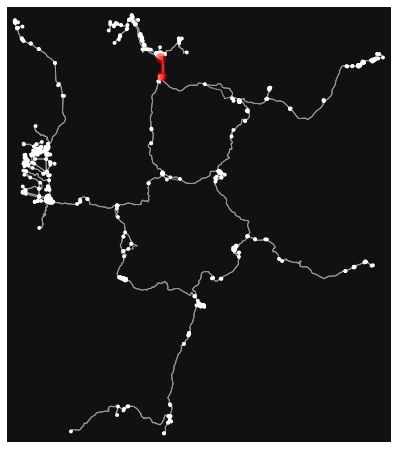

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [40]:
ox.plot.plot_graph_route(G, routes)

### Calculate the times that each edges has been passed through by visitors _on that day_:

In [41]:
edges['travel_times'] = 0

for idx_p, row_p in poi_gdf.iterrows():
    length = []
    for idx_e, row_e in entry_gdf.iterrows():
        temp_length = nx.shortest_path_length(G = G, 
                                  source = row_e['nearest_osm'], 
                                  target = row_p['nearest_osm'], 
                                  weight = 'length',
                                  method = 'dijkstra'
                                 )
        length.append(temp_length)
    
    # get the position in the list with smallest distance
    val, idx = min((val, idx) for (idx, val) in enumerate(length)) 
    
    # from entrance to POI
    start_route = nx.shortest_path(G = G, 
                                   source = entry_gdf.loc[idx, 'nearest_osm'], 
                                   target = row_p['nearest_osm'], 
                                   weight = 'length',
                                   method = 'dijkstra'
                                  )
    
    for i in range(len(start_route) - 1):
        cum_sum = edges.loc[(edges.index.get_level_values('u') == start_route[i]) & (edges.index.get_level_values('v') == start_route[i+1]), 'travel_times'] + row_p['sg_mp__visits_by_day']
        edges.loc[(edges.index.get_level_values('u') == start_route[i]) & (edges.index.get_level_values('v') == start_route[i+1]), 'travel_times'] = cum_sum
    
    # from POI to entrance
    back_route = nx.shortest_path(G = G, 
                                  source = row_p['nearest_osm'], 
                                  target = entry_gdf.loc[idx, 'nearest_osm'], 
                                  weight = 'length',
                                  method = 'dijkstra'
                                 )
    
    for i in range(len(back_route) - 1):
        cum_sum = edges.loc[(edges.index.get_level_values('u') == back_route[i]) & (edges.index.get_level_values('v') == back_route[i+1]), 'travel_times'] + row_p['sg_mp__visits_by_day']
        edges.loc[(edges.index.get_level_values('u') == back_route[i]) & (edges.index.get_level_values('v') == back_route[i+1]), 'travel_times'] = cum_sum

In [61]:
# check summary statistiscs
edges.travel_times.describe() 

count    1935.000000
mean        8.136951
std        35.527206
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max       265.000000
Name: travel_times, dtype: float64

In [60]:
# check edges with nonzero entries
edges[edges['travel_times'] != 0] 

osmid  \
u          v          key                                                      
40840045   158199493  0                      [5545947, 453257574, 104870991]   
           40840049   0                     [74272380, 492206886, 492206887]   
158199493  1209409098 0                                 [15780645, 15780646]   
           40840045   0                      [5545947, 453257574, 104870991]   
40840049   878275942  0                     [492206888, 492206889, 74272378]   
878275942  40840045   0                                            492206889   
           1209407540 0                                [74272376, 104871057]   
158145409  1209476034 0         [104883377, 104932466, 105953484, 353623054]   
           158191828  0    [403445889, 403445890, 104894482, 353623060, 3...   
1209476034 158190269  0                    [104856493, 104883365, 104883375]   
           158145409  0         [104883377, 104932466, 105953484, 353623054]   
                      1                                            403445885   
158191828  158145409  0    [403445889, 403445890, 104894482, 353623060, 3...   
           4254680404 0          [27750361, 104894482, 27749909, 1018319170]   
158149120  158151610  0                                             15779198   
           1209890963 0                                 [23682881, 15777765]   
158151610  256441120  0                                             15778131   
           2877165601 0                                            106211038   
1209890963 158165174  0                                             23682881   
256441120  158151610  0                                             15778131   
2877165601 256439183  0                                            104932517   
158165163  158165190  0                                            103875089   
158165190  158165163  0                                            103875089   
           158165181  0                                            908875840   
158165174  158165181  0                                             15778636   
           158165190  0                                             23682881   
158165181  1209890740 0                                [908875840, 23682208]   
1209890740 158151610  0                                [23682208, 106211038]   
158190269  1209406578 0          [108967130, 15780875, 353675124, 104871126]   
           1209476034 0                    [104883375, 104856493, 104883365]   
1209406578 1209409098 0                    [104871120, 104871126, 104870991]   
           158190269  0          [108967130, 15780875, 353675124, 104871126]   
158191622  4968896794 0            [27749937, 27749818, 23681963, 105953483]   
           256438060  0                                             23682059   
4968896794 158191764  0                                             27749937   
           158191622  0            [27749937, 27749818, 105953483, 23681963]   
256438060  2877164100 0                     [23682171, 288867468, 288867469]   
158191764  158191774  0    [27749898, 27749899, 15782554, 361642619, 3616...   
                      1                                [27749937, 105953476]   
           4968896794 0                                             27749937   
158191774  4254680404 0                                            105953476   
           158191764  0                                [27749937, 105953476]   
4254680404 158191774  0                                            105953476   
                      1                                [27749906, 426161317]   
           158191828  0          [27750361, 1018319170, 104894482, 27749909]   
1209409098 158199493  0                                 [15780645, 15780646]   
           1209406578 0                    [104871120, 104871126, 104870991]   
2877164100 158149120  0                                             15777765   
256439183  158191622  0                                             236

### Let's color code edges based on the number of visitors that may have passed through each each road segment, using Red/Yellow/Green palettes:

In [64]:
m = edges.explore(tiles = 'Stamen Terrain',
              column = 'travel_times', 
              cmap = 'RdYlGn_r',
              scheme = 'NaturalBreaks',
              k = 5,
              vmin = 0,
              highlight = True,
              tooltip = ['name', 'travel_times'], # displayed upon hovering
              popup = True, # all columns displayed upon clicking
              legend_kwds = {
                  'caption': 'Congestion',
                  'scale': False,
                  'colorbar': False
              }
             )
entry_gdf.explore(m = m, 
                  marker_type = 'marker',
                  tooltip = ['entrance']
                 ) # entrances

In [67]:
m.save(f"../map/netwrok_{park}_{day}.html")